In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from perceptron import Perceptron

## 2-A

In [2]:
df=pd.read_csv("input/weatherHistory.csv")
df['Formatted Date'] = df['Formatted Date'].map(lambda x: x.rstrip('021+ '))
df['Formatted Date'] = df['Formatted Date'].str.replace(r'\.', '', regex=True)
df['Formatted Date'] = pd.to_datetime(df['Formatted Date']).dt.date
# df['Formatted Date']=pd.to_datetime(df['Formatted Date'], format='%Y-%m-%d %H:%M:%S')
df['DayOfYear']=df['Formatted Date'].copy()

for i in range(len(df[ "Formatted Date"])):
    if df[ "Formatted Date"][i].year!=2008 and df[ "Formatted Date"][i].year!=2012 and df[ "Formatted Date"][i].year!=2016:
        a=0
    else:
        a=1
    if df[ "Formatted Date"][i].month==1:
        df['DayOfYear'][i]=df["Formatted Date"][i].day
    elif df[ "Formatted Date"][i].month==2:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+31
    elif df[ "Formatted Date"][i].month==3:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+59+a
    elif df[ "Formatted Date"][i].month==4:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
    elif df[ "Formatted Date"][i].month==5:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+120+a
    elif df[ "Formatted Date"][i].month==6:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+151+a
    elif df[ "Formatted Date"][i].month==7:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+181+a
    elif df[ "Formatted Date"][i].month==8:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+212+a
    elif df[ "Formatted Date"][i].month==9:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+243+a
    elif df[ "Formatted Date"][i].month==10:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+273+a
    elif df[ "Formatted Date"][i].month==11:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+304+a
    elif df[ "Formatted Date"][i].month==12:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+334+a
df['DayOfYear']

C:\Users\Alireza\AppData\Local\Temp\ipykernel_8408\2050277128.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
C:\Users\Alireza\AppData\Local\Temp\ipykernel_8408\2050277128.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
C:\Users\Alireza\AppData\Local\Temp\ipykernel_8408\2050277128.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus

0         91
1         91
2         91
3         91
4         91
        ... 
96448    253
96449    253
96450    253
96451    253
96452    253
Name: DayOfYear, Length: 96453, dtype: object

In [3]:
df

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary,DayOfYear
0,2006-04-01,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.,91
1,2006-04-01,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.,91
2,2006-04-01,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.,91
3,2006-04-01,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.,91
4,2006-04-01,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.,91
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96448,2016-09-09,Partly Cloudy,rain,26.016667,26.016667,0.43,10.9963,31.0,16.1000,0.0,1014.36,Partly cloudy starting in the morning.,253
96449,2016-09-09,Partly Cloudy,rain,24.583333,24.583333,0.48,10.0947,20.0,15.5526,0.0,1015.16,Partly cloudy starting in the morning.,253
96450,2016-09-09,Partly Cloudy,rain,22.038889,22.038889,0.56,8.9838,30.0,16.1000,0.0,1015.66,Partly cloudy starting in the morning.,253
96451,2016-09-09,Partly Cloudy,rain,21.522222,21.522222,0.60,10.5294,20.0,16.1000,0.0,1015.95,Partly cloudy starting in the morning.,253


In [4]:
mean_temp=df.groupby('Formatted Date')['Temperature (C)'].mean().reset_index()
mean_temp1=df.groupby('Formatted Date')['DayOfYear'].mean().reset_index()
data = pd.concat([mean_temp, mean_temp1['DayOfYear']], axis=1, join='inner')
data


,Formatted Date,Temperature (C),DayOfYear
0,2006-01-01,3.873148,1.0
1,2006-01-02,5.418519,2.0
2,2006-01-03,2.319444,3.0
3,2006-01-04,2.274074,4.0
4,2006-01-05,2.698148,5.0
...,...,...,...
4013,2016-12-27,0.280324,362.0
4014,2016-12-28,0.224306,363.0
4015,2016-12-29,0.169676,364.0
4016,2016-12-30,0.119444,365.0


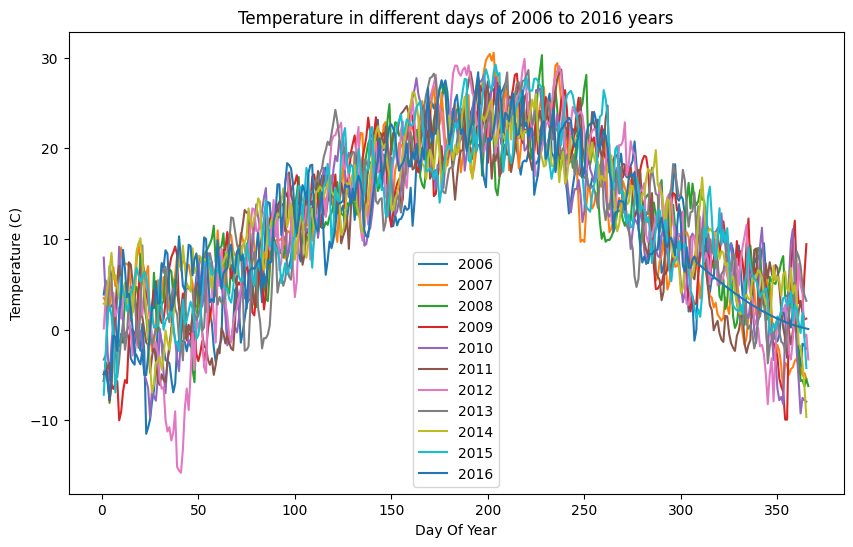

In [5]:
# pd.to_datetime(data['Formatted Date']).dt.year==2006
data['Formatted Date']=pd.to_datetime(data['Formatted Date'])
plt.figure(figsize=(10,6))
for i in range(2006,2017):
    q=data.loc[data['Formatted Date'].dt.year==i]
    plt.plot(q['DayOfYear'],q['Temperature (C)'],label=f'{i}')

plt.xlabel('Day Of Year')
plt.ylabel('Temperature (C)')
plt.legend()
plt.title("Temperature in different days of 2006 to 2016 years")
plt.show()


## 2_B: perceptron

In [6]:
X=data['DayOfYear'].copy().values
Y=data['Temperature (C)'].copy().values

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2)



perceptron=Perceptron(0.00001,0.0001,20)
weights,bias,w,b,losses=perceptron.fit(x_train=X_train,y_train=Y_train)


## 2_C: evaluate 

In [11]:

loss=perceptron.evaluate(X_test,Y_test)
print(loss)

7.769093350002527


## 2_D: predict

In [12]:
def predict(day):
    return perceptron.predict(day)


temp=predict(100)
temp

8.655279789936069

## 2_E: W and b

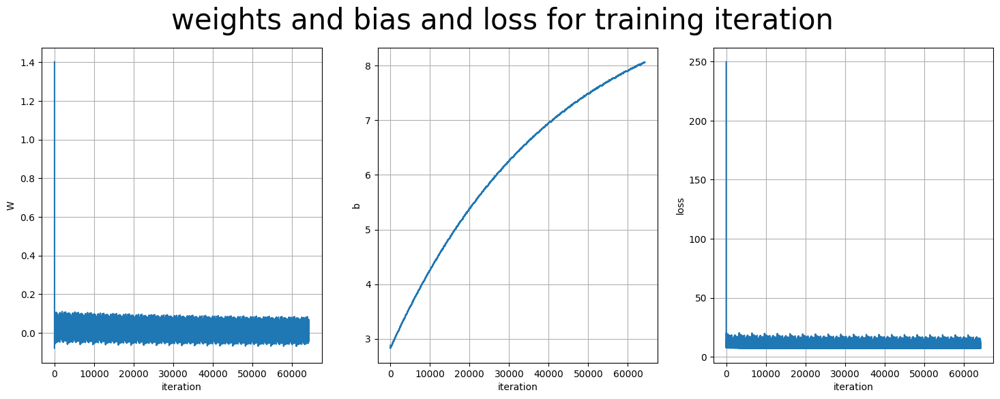

In [9]:
fig,axes=plt.subplots(1,3,figsize=(18,6))
ax1,ax2,ax3=axes.flatten()

x=list(range(1,len(X_train)*20+1))
ax1.plot(x,perceptron.w)
ax1.set_xlabel('iteration')
ax1.set_ylabel('W')
ax1.grid()
ax2.plot(x,perceptron.b)
ax2.set_xlabel('iteration')
ax2.set_ylabel('b')
ax2.grid()
ax3.plot(x,perceptron.losses)
ax3.set_xlabel('iteration')
ax3.set_ylabel('loss')
ax3.grid()

fig.suptitle('weights and bias and loss for training iteration', fontsize=30)
plt.show()